In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Modelo y Preprocesamiento

En esta seccion se probaran disintos metodos de preprocesamiento y modelos para el proyecto.
El pre-procesamiento en general consiste en:

    1. llenado de fechas faltantes
    2. estandarizacion de valores

In [3]:
proyect_dir = os.path.dirname(os.path.abspath(os.getcwd()))
data_folder = "data"
data_folder_dir = os.path.join(os.path.join(proyect_dir,'backend'),data_folder)
processed_data_folder = os.path.join(data_folder_dir,'processed')
file_name = "datos_unidos.csv"
read_dir = os.path.join(processed_data_folder,file_name)

print(read_dir)
df_total = pd.read_csv(read_dir)
df_total["Fecha"] = pd.to_datetime(df_total["Fecha"])

c:\Users\Paul\Documents\Paul\Cursos\Uniandes\maestria_MIAD\202501\proyecto_final\backend\data\processed\datos_unidos.csv


## Preprocesamiento

In [4]:
# Crea el arreglo de fechas 
start_date = df_total["Fecha"].min() #"2019-02-14 00:00:00"
end_date = df_total["Fecha"].max() #"2023-12-31 23:00:00"

datetime_list = pd.date_range(start=start_date, end=end_date, freq='h').to_list()
df_datetime_list = pd.DataFrame(datetime_list ,columns=["Fecha"])

In [5]:
# Une informacion de cada cliente con las fechas 
arr_total_fecha = []
for clt in df_total["cliente"].unique():
    fltr = df_total["cliente"] == clt
    df_temp = pd.merge(df_datetime_list,df_total[fltr], on="Fecha", how = "left")
    df_temp["cliente"] = clt
    arr_total_fecha.append(df_temp)

df_total_fecha = pd.concat(arr_total_fecha)

In [9]:
# Guarda nuevos datos
file_name = "datos_unidos_fechas.csv"
write_dir = os.path.join(processed_data_folder,file_name)
df_total_fecha.to_csv(write_dir, index=False)

### Primera estrategia llenar de 0

**Teoria**
Extrapolar valores implicaria un comportamiento "normal" por lo que se añade este valor para tratar de indicar el comportamiento anormal

**Resultado**
LLenar de 0 antes de crear el modelo, normaliza los 0 y hace que las metricas de algunos modelos amplien su toleracia a anomalias. Por esta razon se mantendran los valores faltantes y luego de calculados los modelos se llenaran

In [10]:
#df_total_fecha_0 = df_total_fecha.fillna(0)

In [12]:
file_name = "datos_unidos_fechas_158.csv"
write_dir = os.path.join(processed_data_folder,file_name)
fltr = df_total_fecha["cliente"].isin(["CLIENTE1","CLIENTE5","CLIENTE8"])
df_total_fecha[fltr].to_csv(write_dir, index=False)

In [13]:
df_total_fecha[fltr].count()

Fecha          130537
Presion        129974
Temperatura    129974
Volumen        129974
cliente        130537
dtype: int64

## Modelo de deteccion

In [ ]:
# Funciones 
def graficar_anomalias_total_clientes(df_con_anomalias):
    # Paleta de colores para las anomalías
    palette_iforest = {
        'alta': 'red',
        'media': 'orange',
        'leve': 'yellow'
    }

    # Graficar anomalías por cliente (solo aquellas que Isolation Forest marcó como anómalas)
    for cliente in df_con_anomalias['cliente'].unique():
        df_cli = df_con_anomalias[df_con_anomalias['cliente'] == cliente]

        fig, axes = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
        fig.suptitle(f'Anomalías por Isolation Forest - {cliente}', fontsize=16)
        
        df_anom = df_cli[
            (df_cli['anomaly_label'] != 'anomalía')
        ]

        # Línea base: todos los datos
        sns.scatterplot(ax=axes[0], data=df_anom, x='Fecha', y='Presion', color='lightgray', s=10, label='normal', alpha=0.5)
        sns.scatterplot(ax=axes[1], data=df_anom, x='Fecha', y='Temperatura', color='lightgray', s=10, label='normal', alpha=0.5)
        sns.scatterplot(ax=axes[2], data=df_anom, x='Fecha', y='Volumen', color='lightgray', s=10, label='normal', alpha=0.5)

        # Solo graficar los puntos marcados como anomalía, categorizados por severidad
        for nivel in ['leve', 'media', 'alta']:
            df_anom = df_cli[
                (df_cli['anomaly_label'] == 'anomalía') &
                (df_cli['nivel_anomalia_iforest'] == nivel)
            ]
            sns.scatterplot(ax=axes[0], data=df_anom, x='Fecha', y='Presion', color=palette_iforest[nivel], s=10, label=nivel)
            sns.scatterplot(ax=axes[1], data=df_anom, x='Fecha', y='Temperatura', color=palette_iforest[nivel], s=10, label=nivel)
            sns.scatterplot(ax=axes[2], data=df_anom, x='Fecha', y='Volumen', color=palette_iforest[nivel], s=10, label=nivel)

        axes[0].set_title('Presión [bar]')
        axes[1].set_title('Temperatura [°C]')
        axes[2].set_title('Volumen [m3]')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

### Z-score

In [23]:
# Reimportar librerías tras reinicio
from sklearn.preprocessing import StandardScaler

# Lista para almacenar resultados
df_scaled_anomaly = []
features = ['Presion', 'Temperatura', 'Volumen']

# Aplicar StandardScaler por cliente y etiquetar anomalías
for cliente in df_total_fecha['cliente'].unique():
    df_cli = df_total_fecha[df_total_fecha['cliente'] == cliente].copy()
    scaler = StandardScaler()

    # Aplicar escalamiento respetando los NaN
    scaler.fit(df_cli[features])
    scaled = scaler.transform(df_cli[features].fillna(0))
    df_cli[['z_Presion', 'z_Temperatura', 'z_Volumen']] = scaled

    # Etiquetado por variable
    for col in features:
        z_col = f'z_{col}'
        anom_col = f'anomalia_{col}'
        df_cli[anom_col] = pd.cut(np.abs(df_cli[z_col]),
                                bins=[-float('inf'), 2, 2.5, 3, float('inf')],
                                labels=['normal', 'leve', 'media', 'alta'])

    df_scaled_anomaly.append(df_cli)

# Concatenar todos los clientes
df_zscore = pd.concat(df_scaled_anomaly, ignore_index=True)
df_zscore[features] = df_zscore[features].fillna(0)

# Asignacion de valores de anomalia
condicion_normal = (df_zscore[["anomalia_Presion", "anomalia_Temperatura", "anomalia_Volumen"]] == 'normal').all(axis=1)

# Create new column based on the condition
df_zscore["anomaly_label"] = np.where(condicion_normal, "normal", "anomalia")
df_zscore["anomaly_level"] = 'leve'
condicion_media = (df_zscore[["anomalia_Presion", "anomalia_Temperatura", "anomalia_Volumen"]] == 'media').any(axis=1)
df_zscore.loc[condicion_media, 'anomaly_level'] = 'media'
condicion_alta = (df_zscore[["anomalia_Presion", "anomalia_Temperatura", "anomalia_Volumen"]] == 'alta').any(axis=1)
df_zscore.loc[condicion_alta, 'anomaly_level'] = 'alta'


# Resumen por variable
summary_model_ready = {
    "Presion": df_zscore['anomalia_Presion'].value_counts(),
    "Temperatura": df_zscore['anomalia_Temperatura'].value_counts(),
    "Volumen": df_zscore['anomalia_Volumen'].value_counts()
}

anomaly_model_df = pd.DataFrame(summary_model_ready).fillna(0).astype(int)
anomaly_model_df

,Presion,Temperatura,Volumen
normal,796065,830683,830144
alta,40660,23163,19492
leve,21440,14658,14236
media,12089,1750,6382


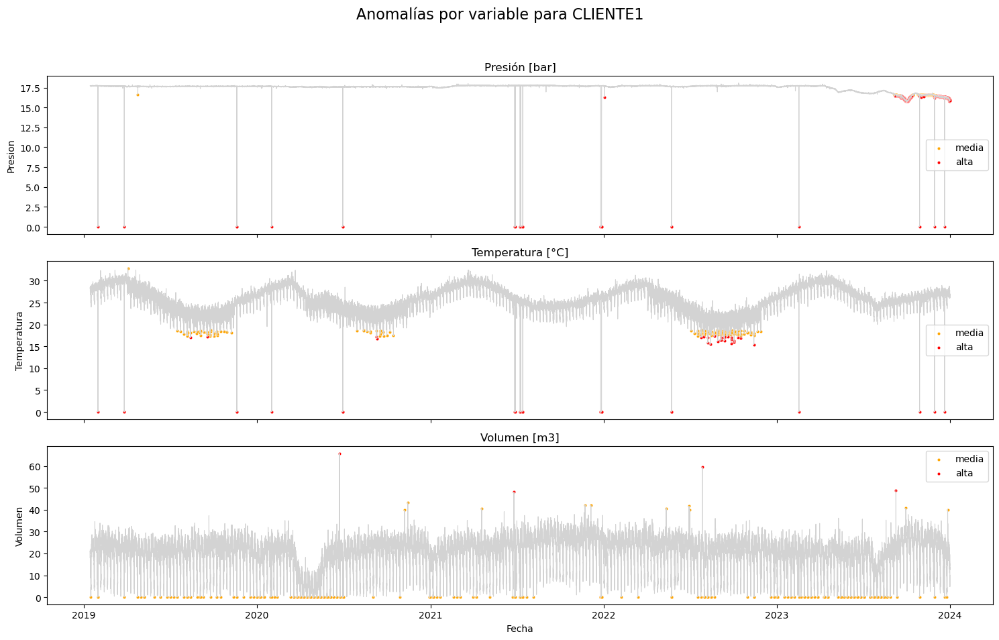

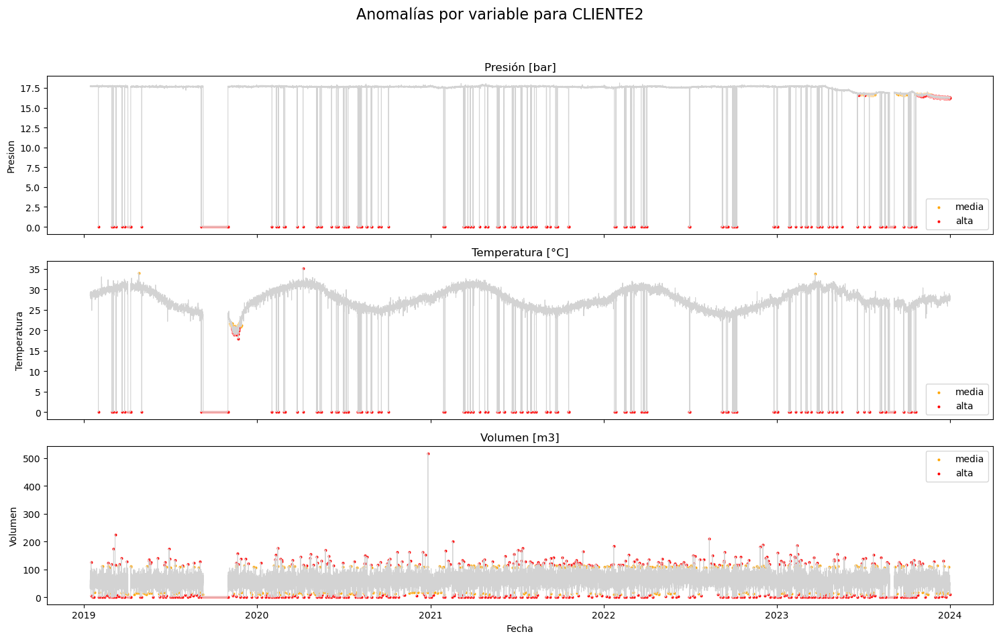

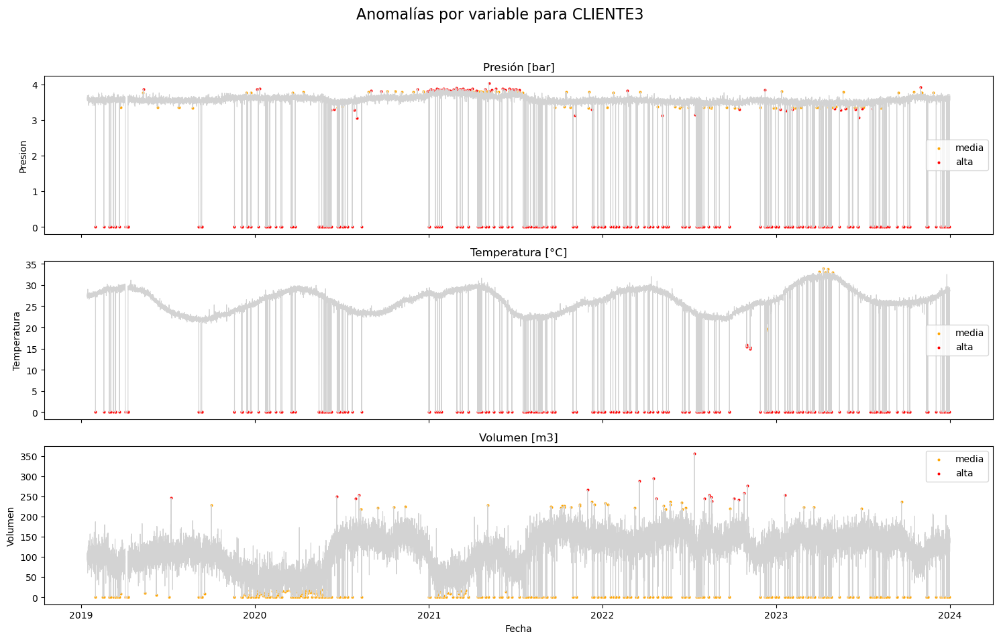

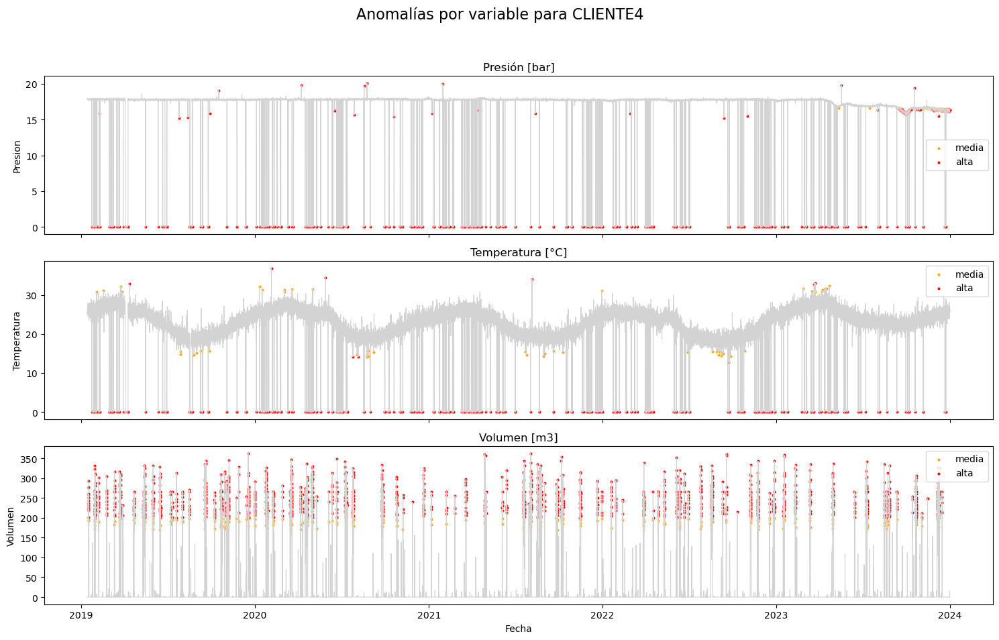

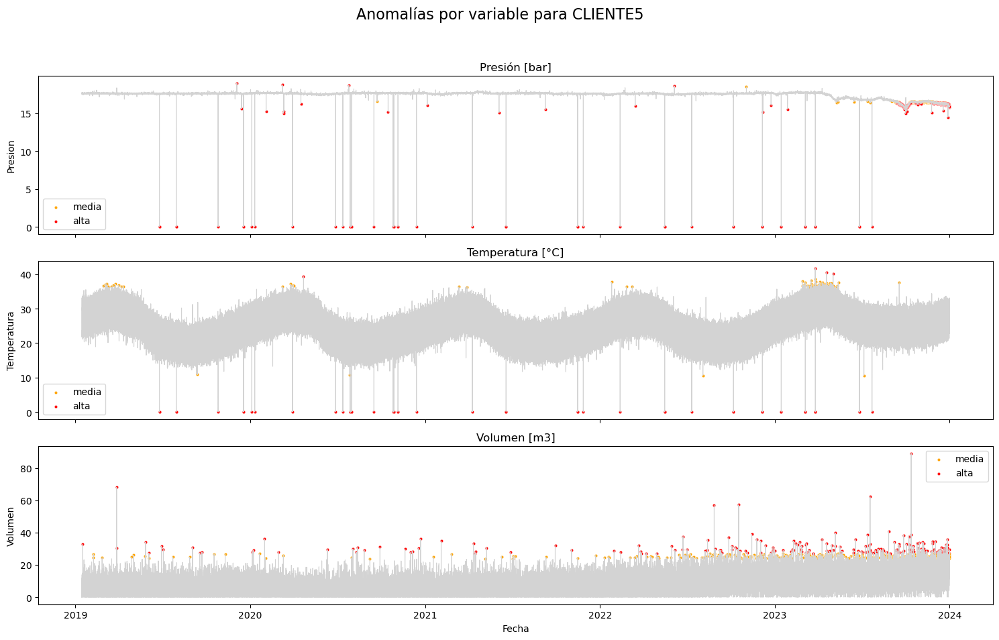

...

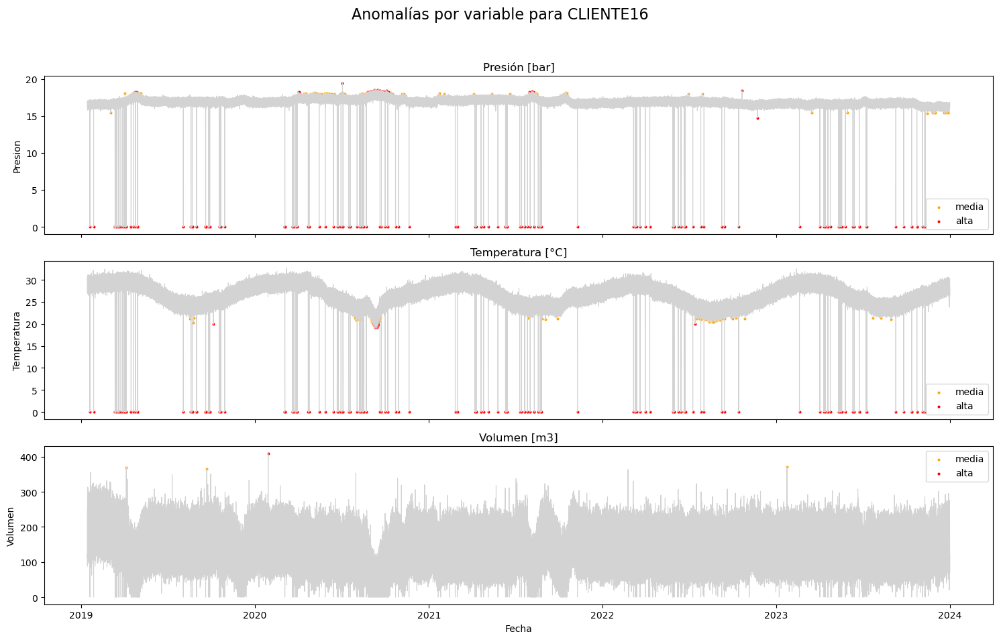

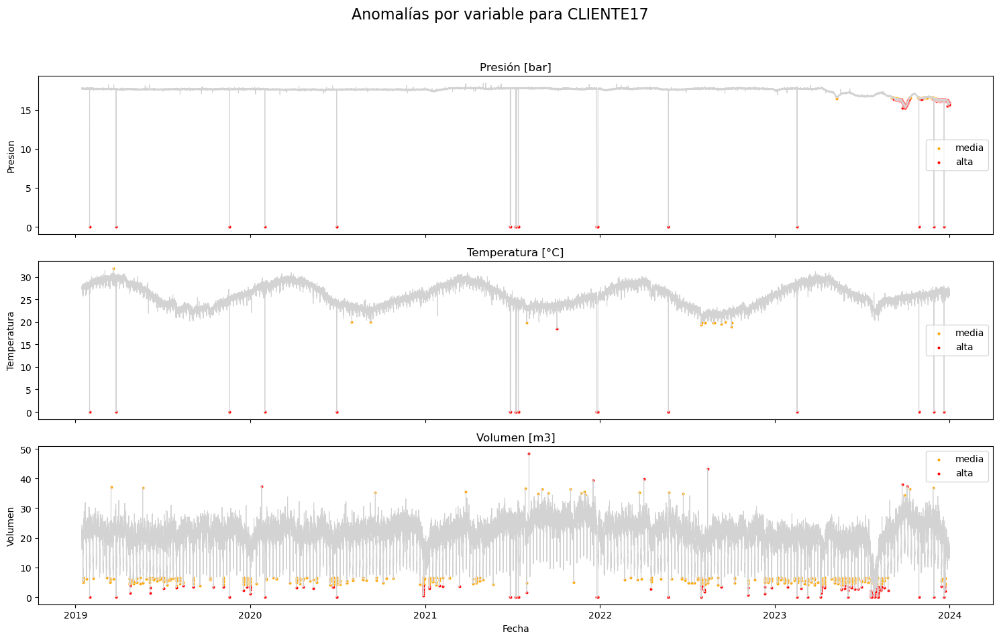

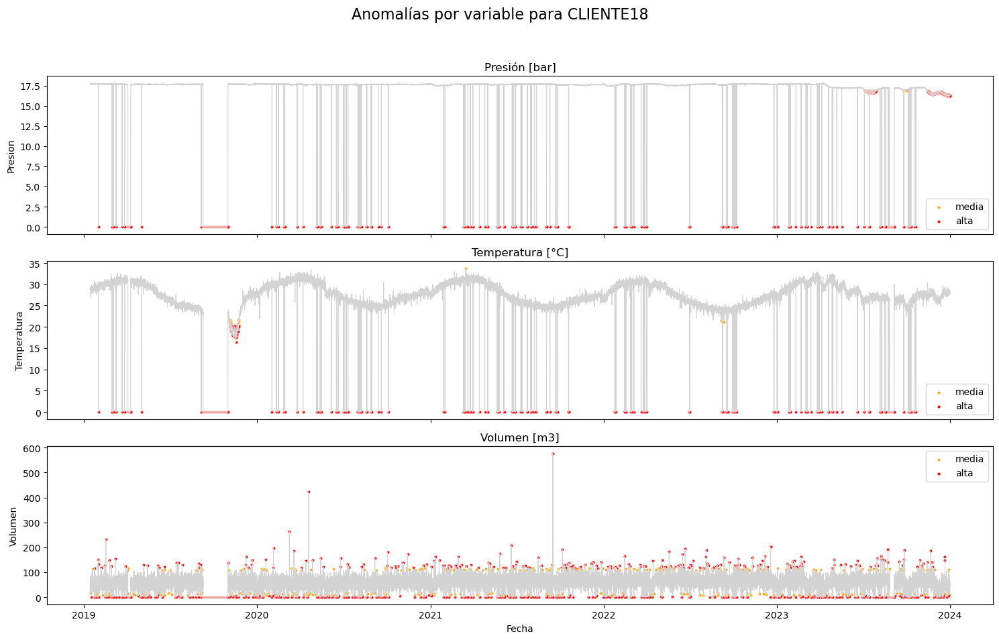

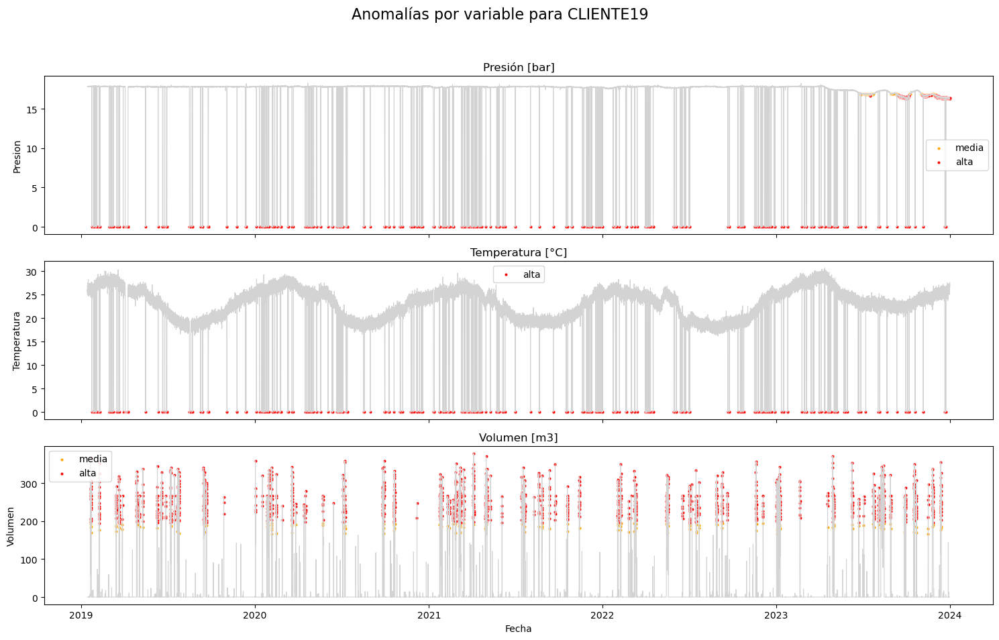

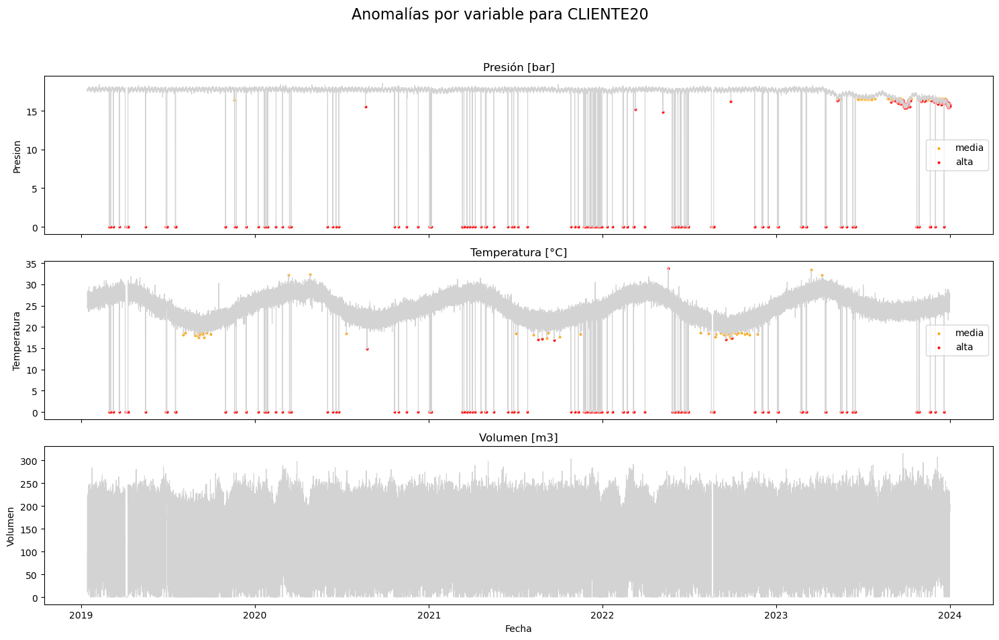

In [24]:
# Paleta por nivel
palette_variable = {
    'baja': 'yellow',
    'media': 'orange',
    'alta': 'red'
}

# Graficar anomalías por variable de forma independiente
for cliente in df_zscore['cliente'].unique():
    df_cli = df_zscore[df_zscore['cliente'] == cliente]

    fig, axes = plt.subplots(3, 1, figsize=(15, 10), sharex=True)
    fig.suptitle(f'Anomalías por variable para {cliente}', fontsize=16)

    # Presión
    sns.lineplot(ax=axes[0], data=df_cli, x='Fecha', y='Presion', color='lightgray', linewidth=0.8)
    for nivel in ['baja', 'media', 'alta']:
        sns.scatterplot(
            ax=axes[0],
            data=df_cli[df_cli['anomalia_Presion'] == nivel],
            x='Fecha', y='Presion',
            color=palette_variable[nivel], s=10, label=nivel
        )
    axes[0].set_title('Presión [bar]')

    # Temperatura
    sns.lineplot(ax=axes[1], data=df_cli, x='Fecha', y='Temperatura', color='lightgray', linewidth=0.8)
    for nivel in ['baja', 'media', 'alta']:
        sns.scatterplot(
            ax=axes[1],
            data=df_cli[df_cli['anomalia_Temperatura'] == nivel],
            x='Fecha', y='Temperatura',
            color=palette_variable[nivel], s=10, label=nivel
        )
    axes[1].set_title('Temperatura [°C]')

    # Volumen
    sns.lineplot(ax=axes[2], data=df_cli, x='Fecha', y='Volumen', color='lightgray', linewidth=0.8)
    for nivel in ['baja', 'media', 'alta']:
        sns.scatterplot(
            ax=axes[2],
            data=df_cli[df_cli['anomalia_Volumen'] == nivel],
            x='Fecha', y='Volumen',
            color=palette_variable[nivel], s=10, label=nivel
        )
    axes[2].set_title('Volumen [m3]')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


### Isolation Forest

In [25]:
from sklearn.ensemble import IsolationForest

# Reemplazar valores faltantes por 0 (considerados potencialmente anómalos)
df_total_fecha_isloation = df_total_fecha.fillna(0)
# Lista para resultados del modelo por cliente
isolation_results = []

# Entrenar Isolation Forest por cliente
for cliente in df_total_fecha_isloation['cliente'].unique():
    df_cli = df_total_fecha_isloation[df_total_fecha_isloation['cliente'] == cliente].copy()
    X = df_cli[['Presion', 'Temperatura', 'Volumen']]

    # Escalar los datos
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Entrenamiento del modelo
    iso_model = IsolationForest(n_estimators=100, contamination='auto', random_state=42)
    df_cli['anomaly_label'] = iso_model.fit_predict(X_scaled)
    df_cli['anomaly_score'] = iso_model.decision_function(X_scaled)

    # Mapear etiquetas
    df_cli['anomaly_label'] = df_cli['anomaly_label'].map({1: 'normal', -1: 'anomalía'})

    # Clasificación por severidad del score
    q01 = df_cli['anomaly_score'].quantile(0.01)
    q05 = df_cli['anomaly_score'].quantile(0.05)

    def clasificar_severidad(score):
        if score < q01:
            return 'alta'
        elif score < q05:
            return 'media'
        else:
            return 'leve'

    df_cli['nivel_anomalia_iforest'] = df_cli['anomaly_score'].apply(clasificar_severidad)

    isolation_results.append(df_cli)

# Concatenamos los resultados
df_iforest = pd.concat(isolation_results, ignore_index=True)

# Resumen por cliente y severidad
resumen_iforest = df_iforest\
    .groupby(['cliente', 'anomaly_label','nivel_anomalia_iforest'])[["Fecha"]].count()

resumen_iforest

Fecha
cliente   anomaly_label nivel_anomalia_iforest       
CLIENTE1  anomalía      alta                      436
                        leve                     6800
                        media                    1740
          normal        leve                    34536
CLIENTE10 anomalía      alta                      436
...                                               ...
CLIENTE8  anomalía      media                    1742
          normal        leve                    36871
CLIENTE9  anomalía      leve                     2778
                        media                    2175
          normal        leve                    38559

[71 rows x 1 columns]

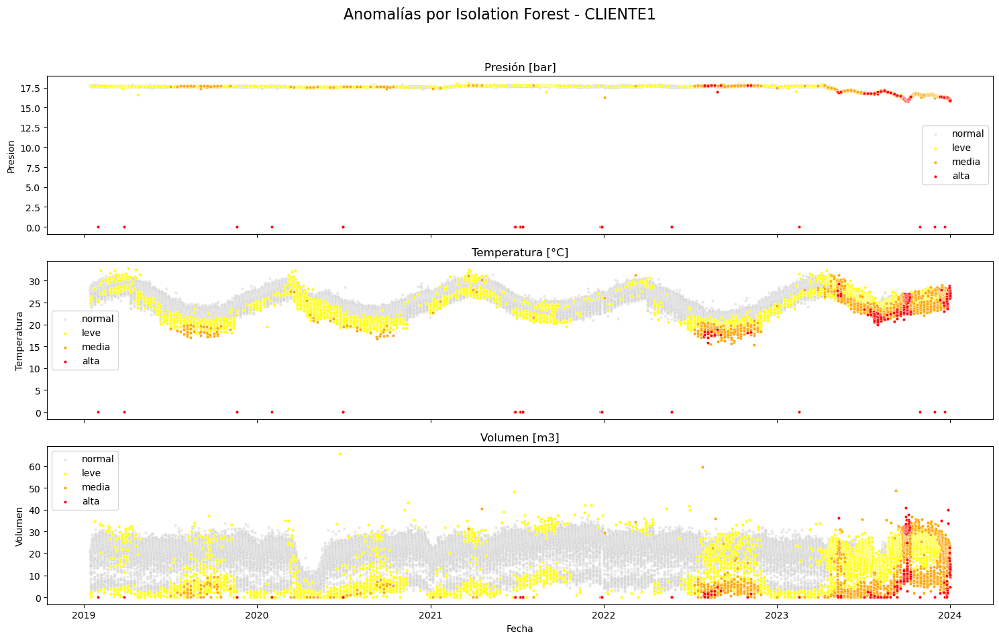

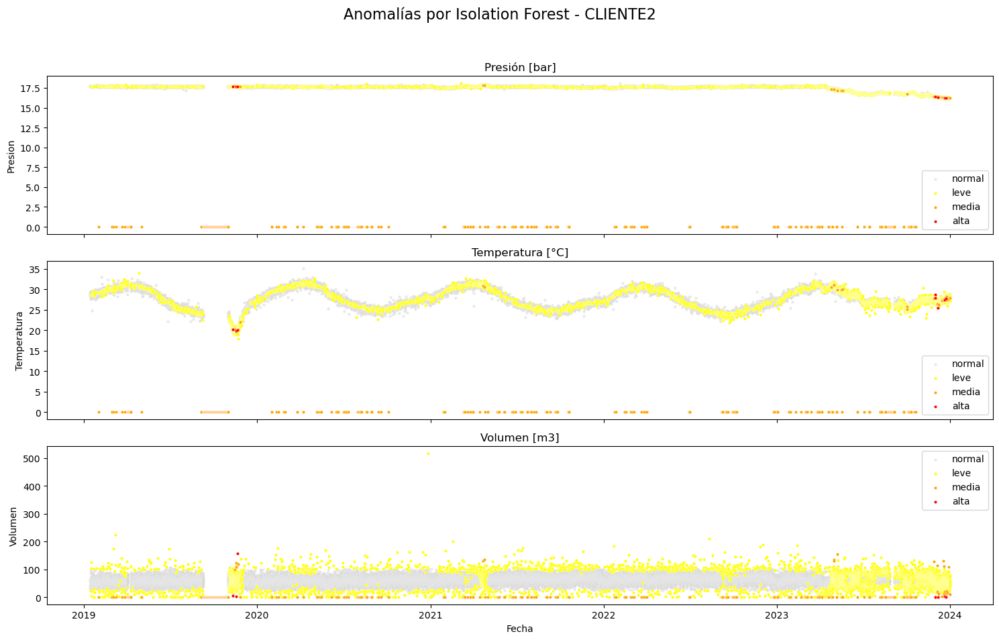

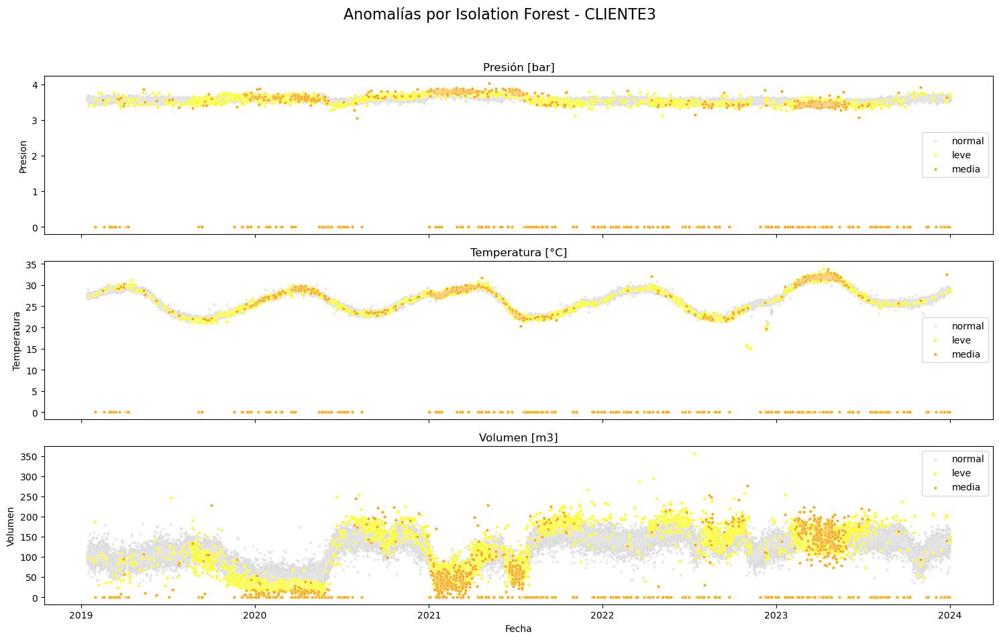

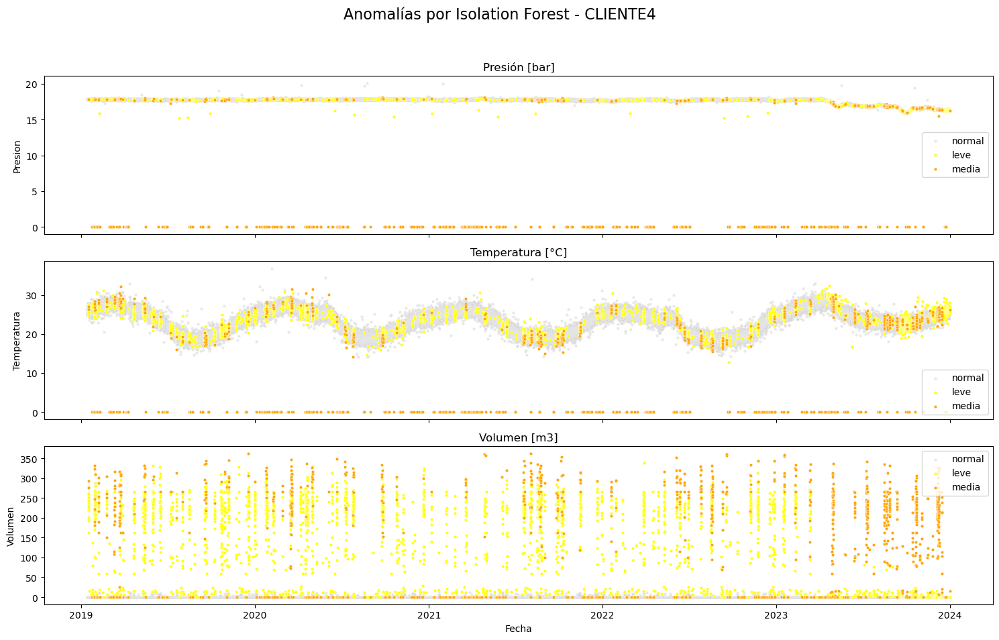

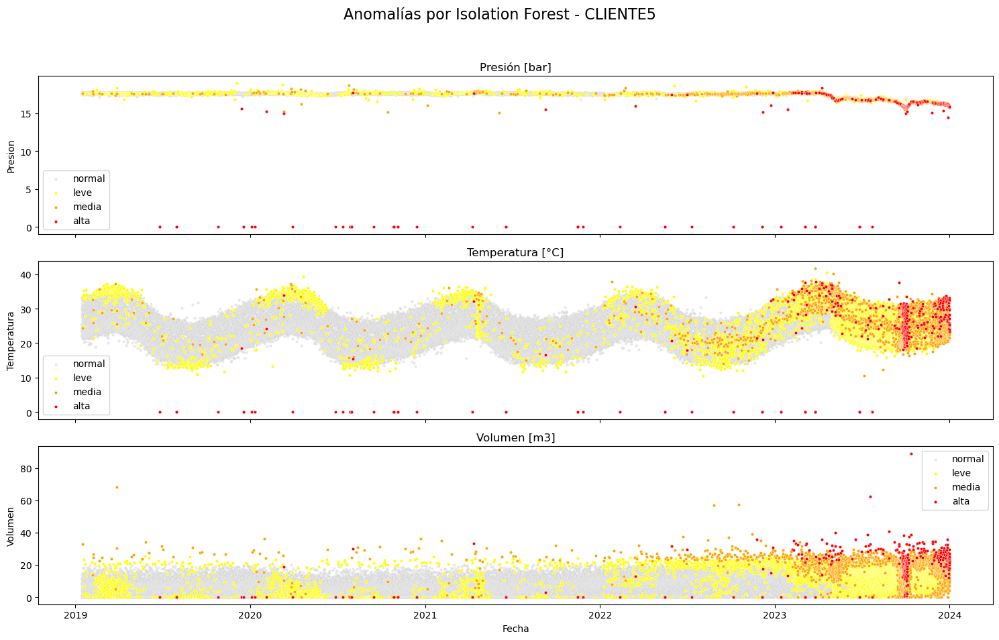

...

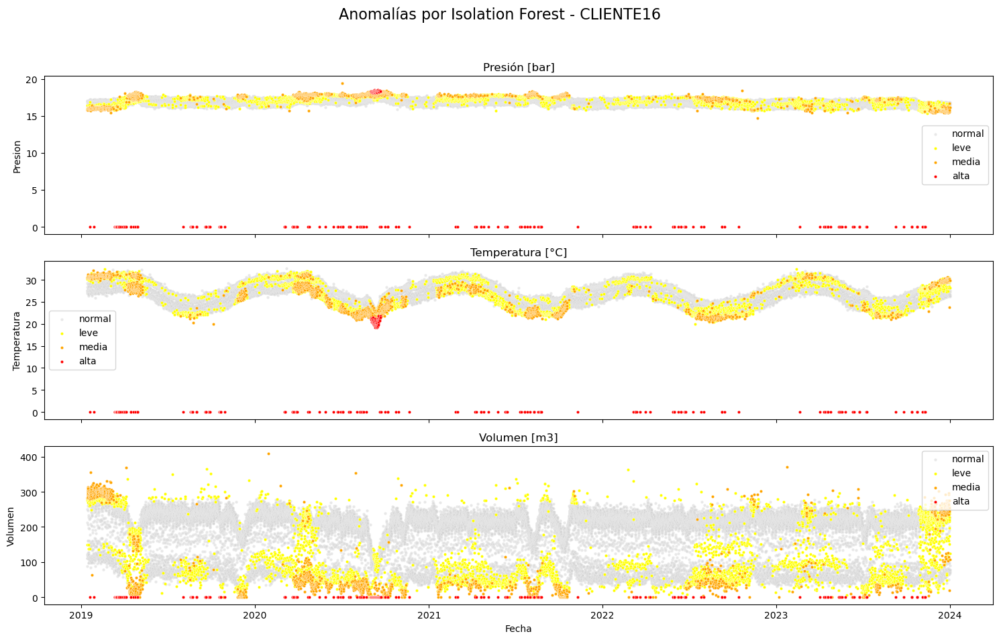

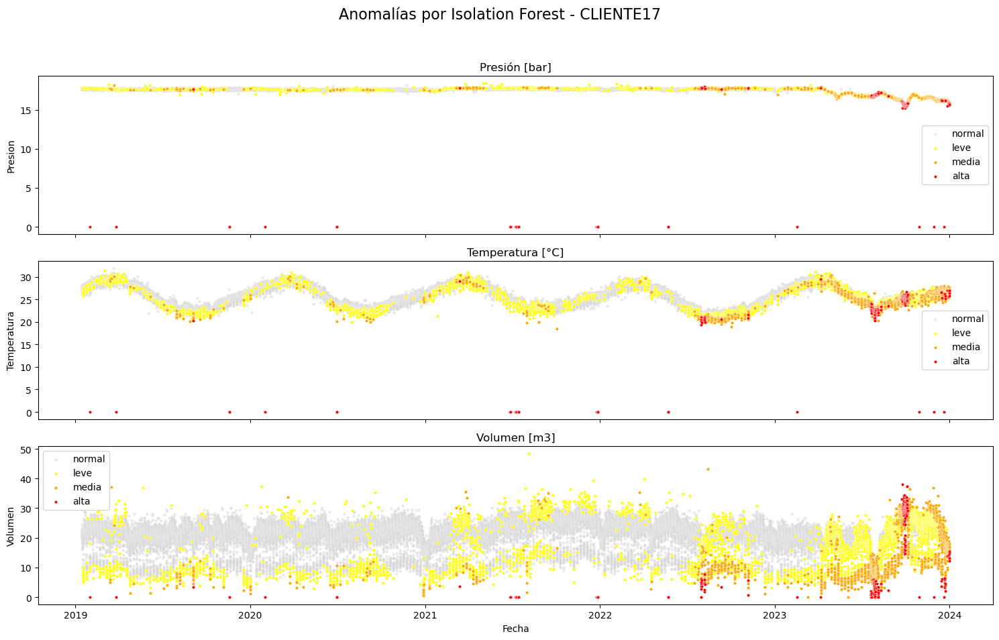

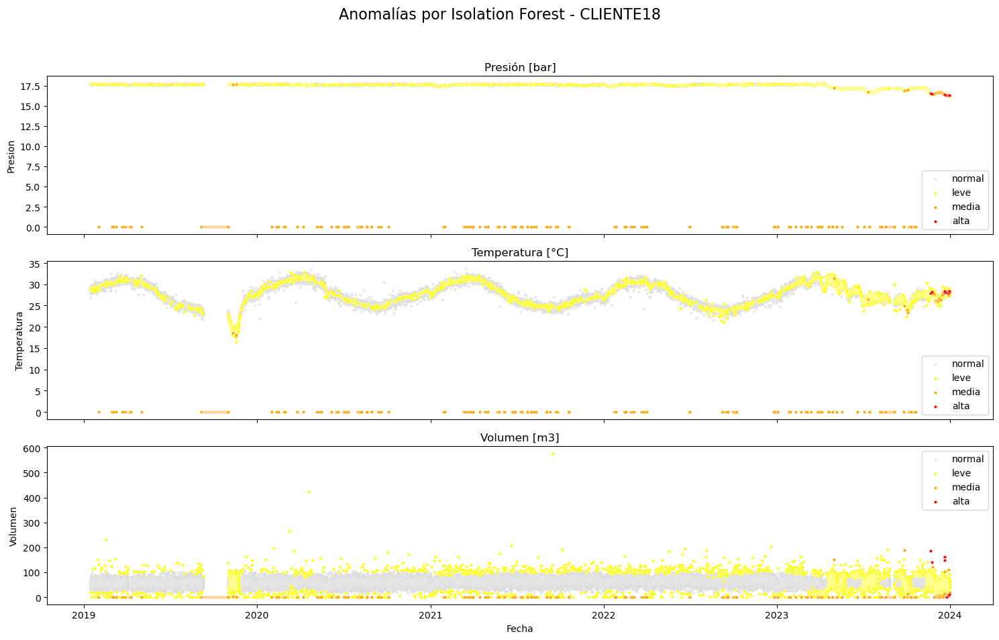

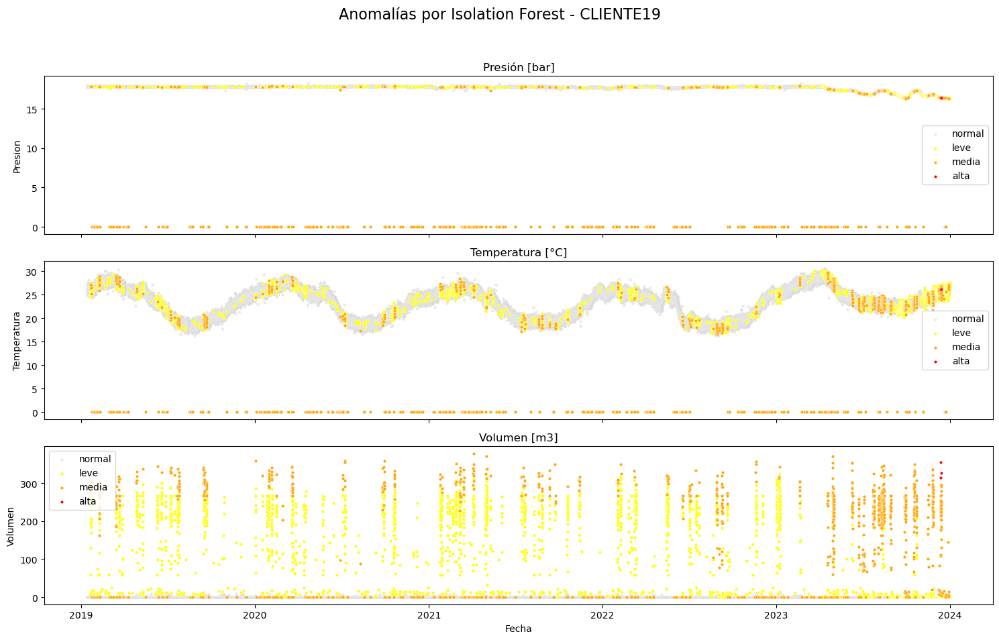

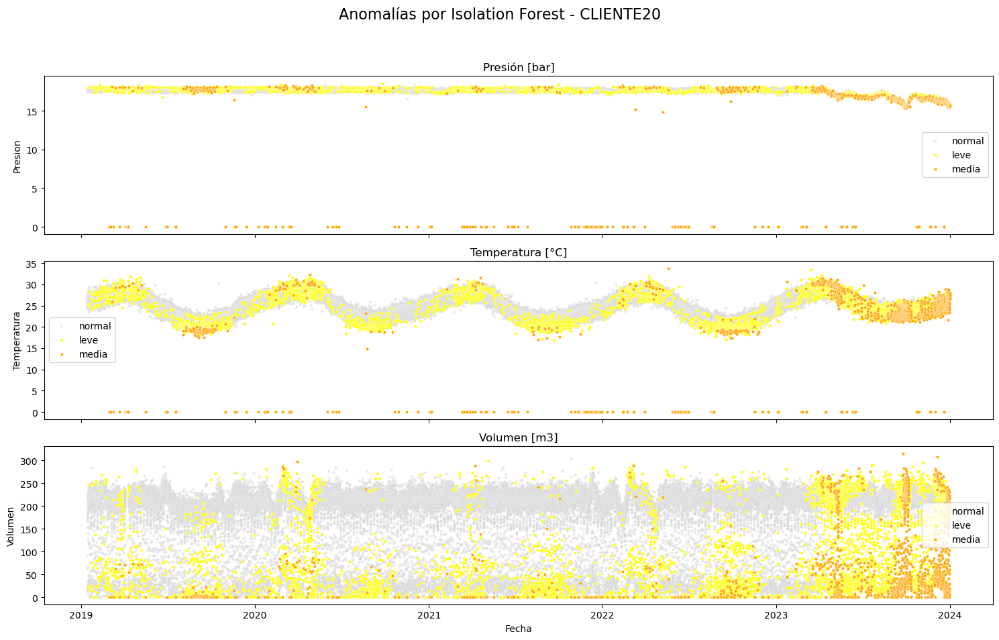

In [26]:
graficar_anomalias_total_clientes(df_iforest)

### Isolation Forest con Var temporales

In [27]:
# Añadir variables temporales al dataset
df_total_fecha_isloation_temp = df_total_fecha.fillna(0)

df_total_fecha_isloation_temp['hora'] = df_total_fecha_isloation_temp['Fecha'].dt.hour
df_total_fecha_isloation_temp['dia_semana'] = df_total_fecha_isloation_temp['Fecha'].dt.dayofweek  # 0 = lunes, 6 = domingo
df_total_fecha_isloation_temp['mes'] = df_total_fecha_isloation_temp['Fecha'].dt.month
df_total_fecha_isloation_temp['dia_mes'] = df_total_fecha_isloation_temp['Fecha'].dt.day

# Lista para guardar resultados con variables temporales
iforest_temp_results = []

# Entrenar Isolation Forest por cliente con variables temporales
for cliente in df_total_fecha_isloation_temp['cliente'].unique():
    df_cli = df_total_fecha_isloation_temp[df_total_fecha_isloation_temp['cliente'] == cliente].copy()
    features = ['Presion', 'Temperatura', 'Volumen', 'hora', 'dia_semana', 'mes']
    X = df_cli[features]
    
    # Escalamiento
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Modelo Isolation Forest
    model = IsolationForest(n_estimators=100, contamination='auto', random_state=42)
    df_cli['anomaly_label'] = model.fit_predict(X_scaled)
    df_cli['anomaly_score'] = model.decision_function(X_scaled)
    df_cli['anomaly_label'] = df_cli['anomaly_label'].map({1: 'normal', -1: 'anomalía'})

    # Clasificar severidad
    q01 = df_cli['anomaly_score'].quantile(0.01)
    q05 = df_cli['anomaly_score'].quantile(0.05)

    def clasificar_severidad(score):
        if score < q01:
            return 'alta'
        elif score < q05:
            return 'media'
        else:
            return 'leve'

    df_cli['nivel_anomalia_iforest'] = df_cli['anomaly_score'].apply(clasificar_severidad)
    iforest_temp_results.append(df_cli)

# Concatenar resultados
df_iforest_temporal = pd.concat(iforest_temp_results, ignore_index=True)

# Resumen por cliente
resumen_iforest_temporal = df_iforest_temporal\
    .groupby(['cliente', 'anomaly_label','nivel_anomalia_iforest'])[["Fecha"]].count()

resumen_iforest_temporal

Fecha
cliente   anomaly_label nivel_anomalia_iforest       
CLIENTE1  anomalía      alta                      436
                        leve                    12674
                        media                    1740
          normal        leve                    28662
CLIENTE10 anomalía      alta                      434
...                                               ...
CLIENTE8  normal        leve                    27571
CLIENTE9  anomalía      alta                      436
                        leve                     3859
                        media                    1740
          normal        leve                    37477

[80 rows x 1 columns]

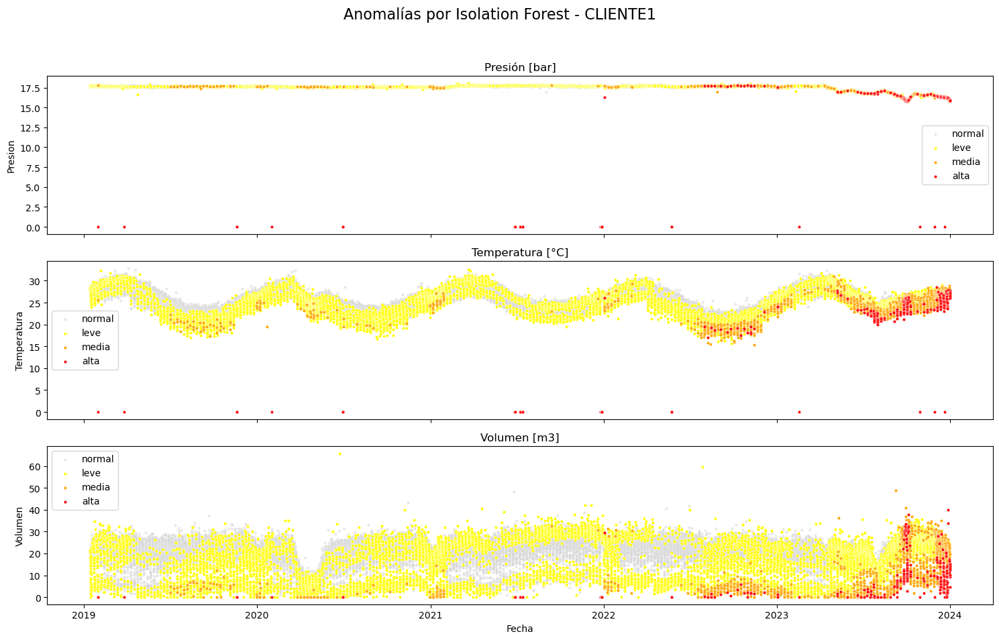

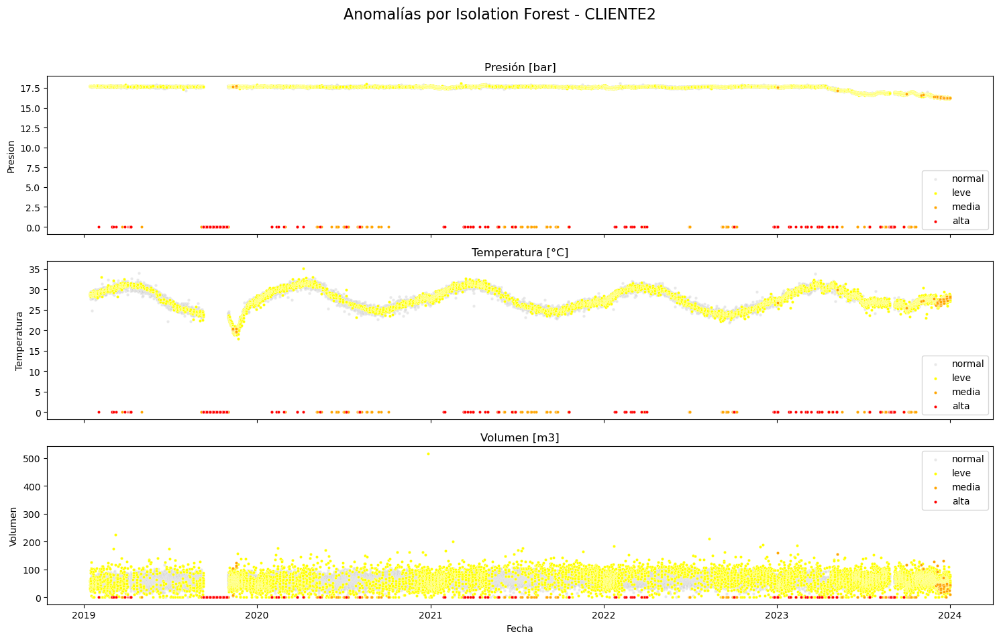

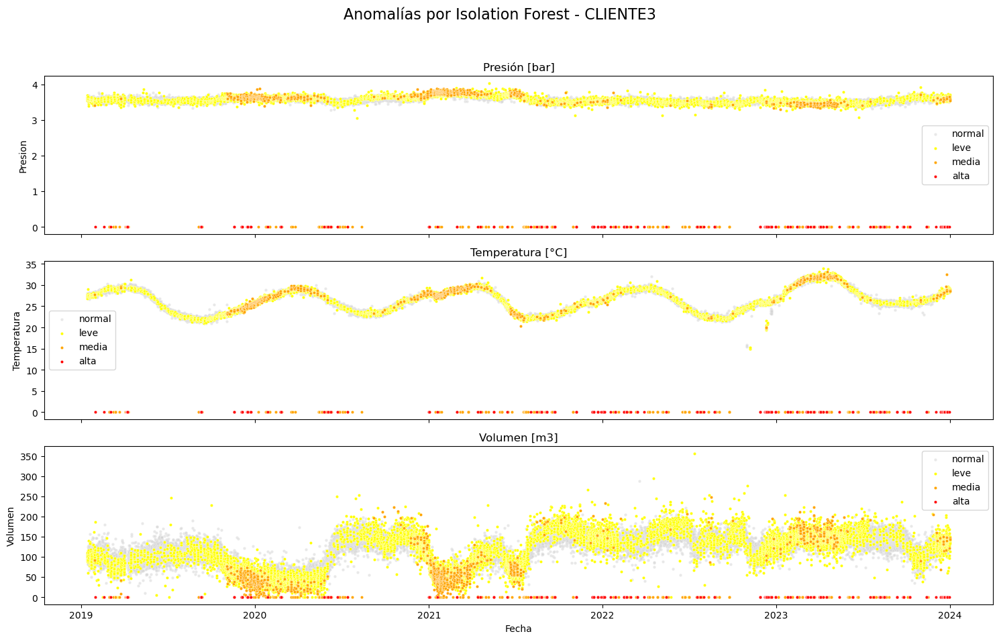

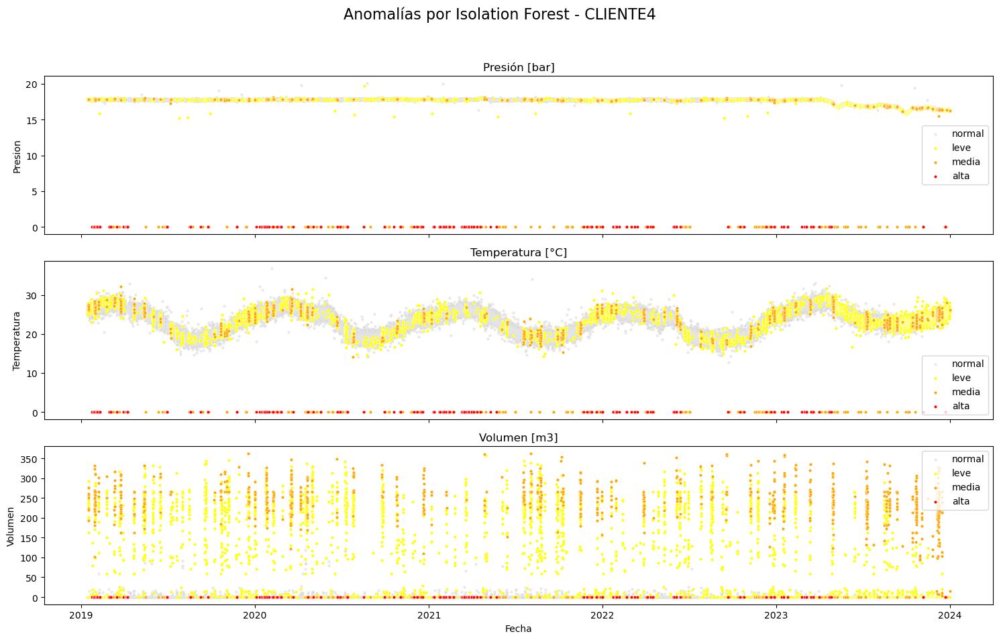

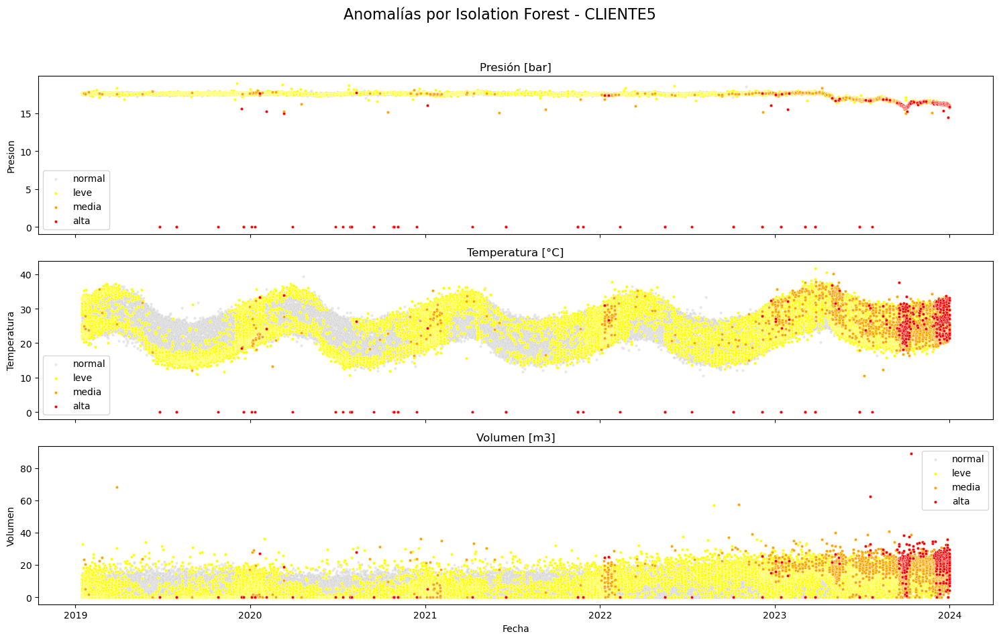

...

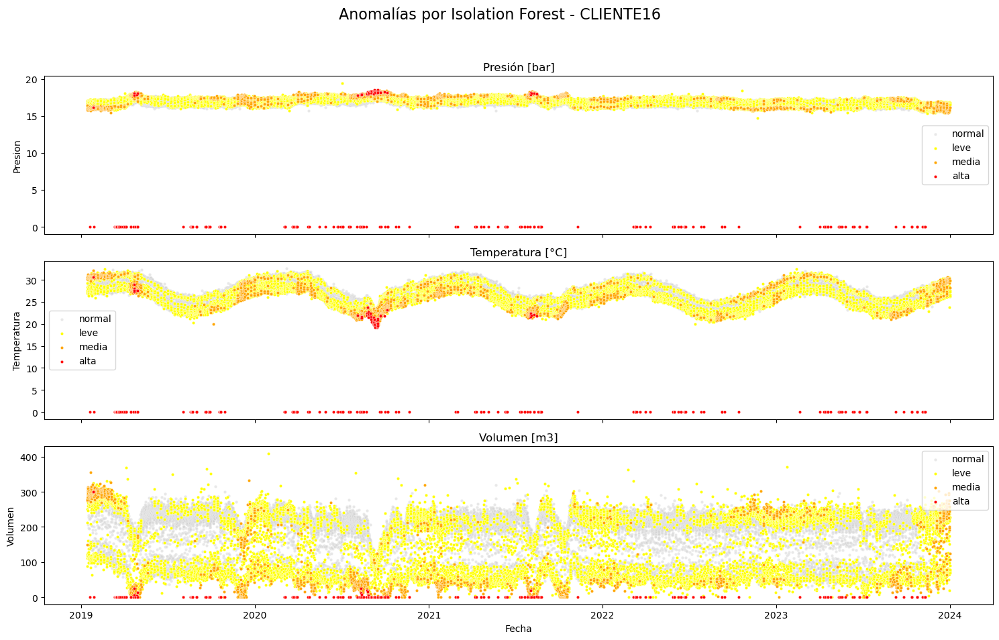

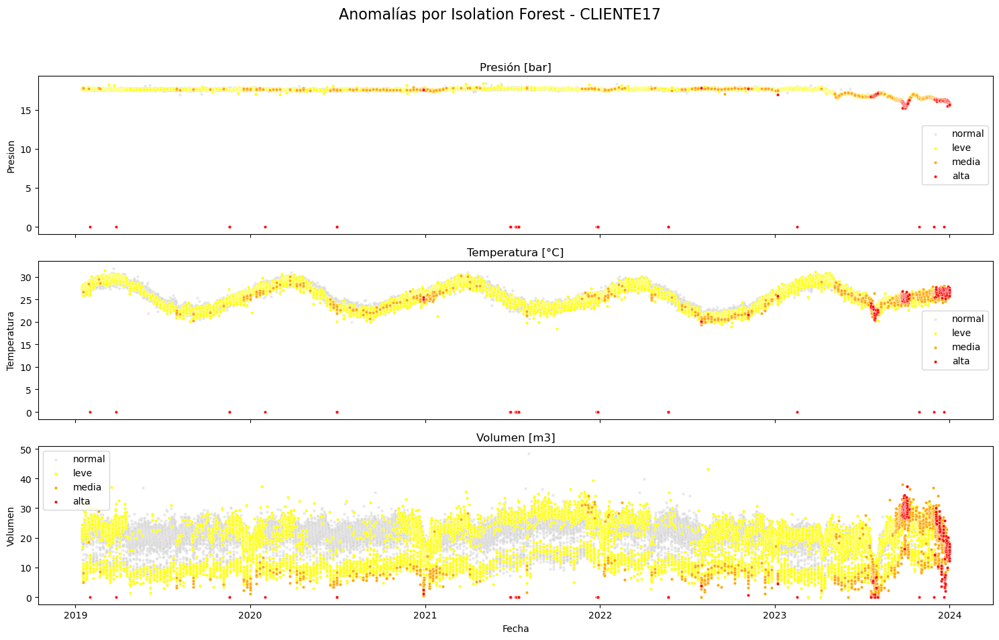

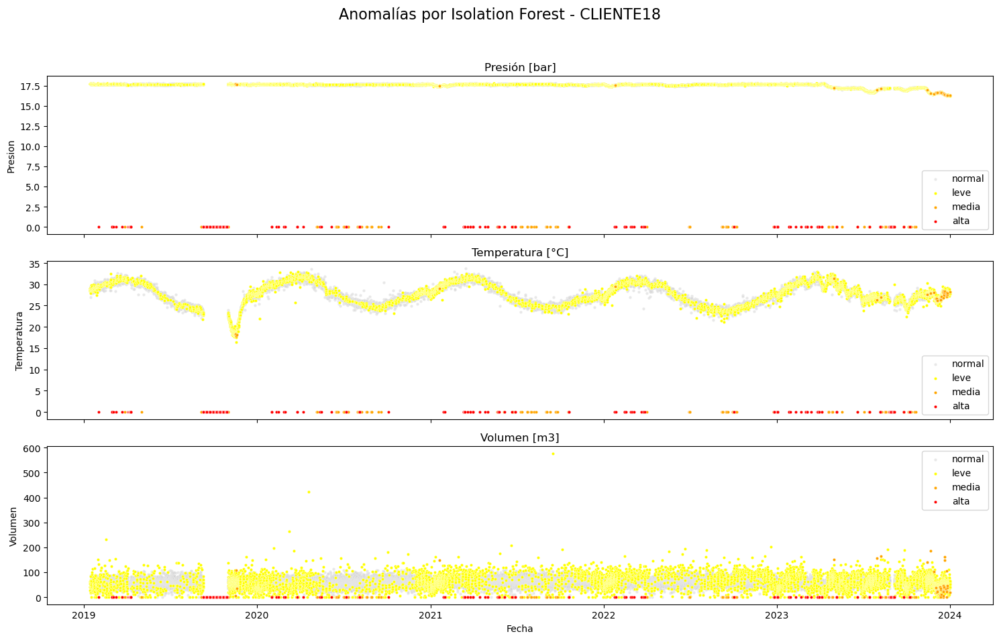

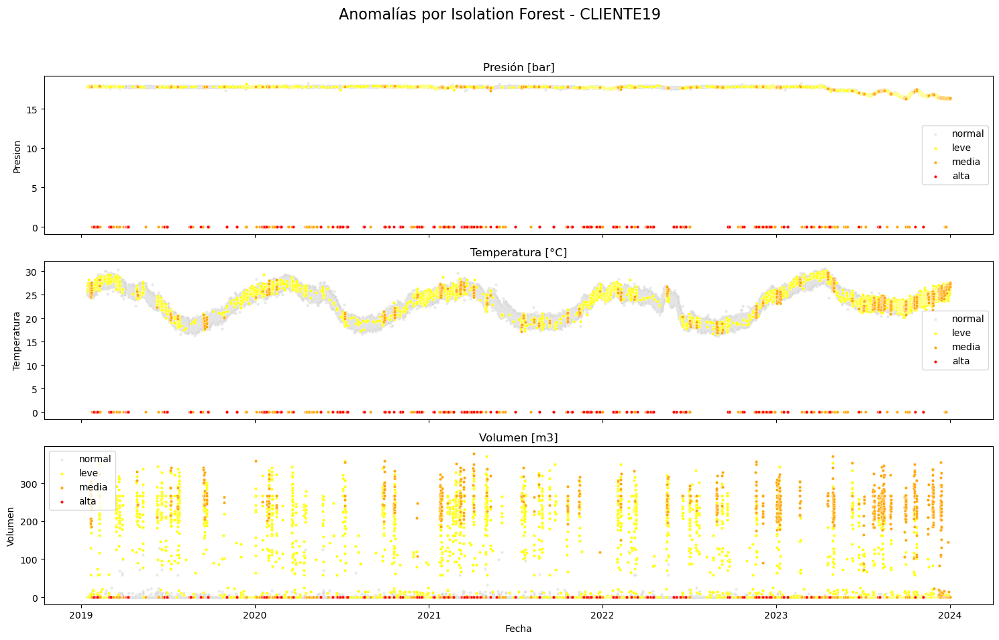

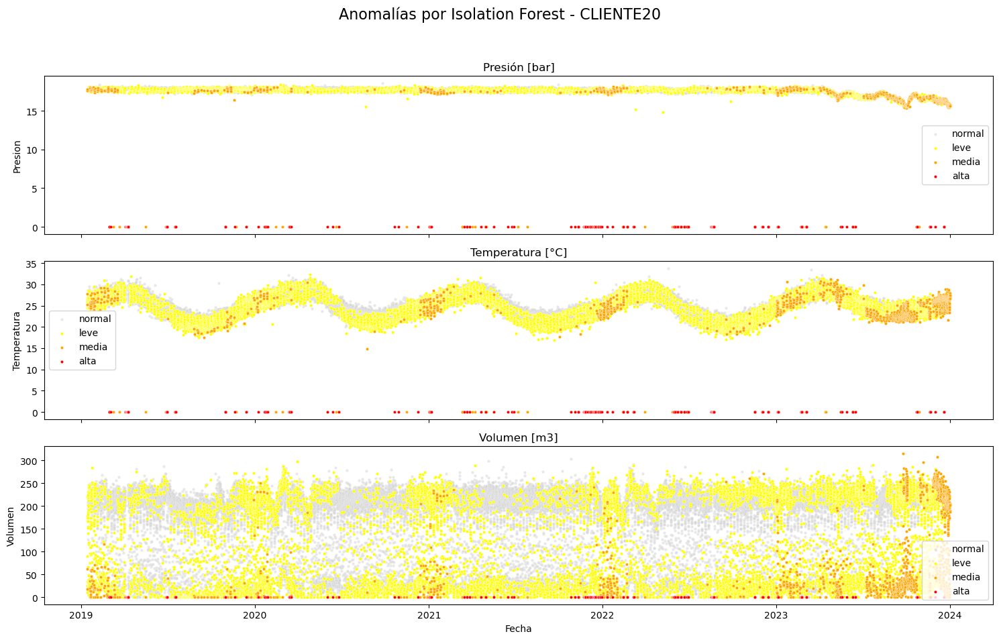

In [28]:
graficar_anomalias_total_clientes(df_iforest_temporal)

### Isolation Forest con Var temporales y diferencias 

In [29]:
# Añadir variables temporales al dataset
df_total_fecha_isloation_temp_diff = df_total_fecha.fillna(0)

df_total_fecha_isloation_temp_diff['hora'] = df_total_fecha_isloation_temp_diff['Fecha'].dt.hour
df_total_fecha_isloation_temp_diff['dia_semana'] = df_total_fecha_isloation_temp_diff['Fecha'].dt.dayofweek  # 0 = lunes, 6 = domingo
df_total_fecha_isloation_temp_diff['mes'] = df_total_fecha_isloation_temp_diff['Fecha'].dt.month
df_total_fecha_isloation_temp_diff['dia_mes'] = df_total_fecha_isloation_temp_diff['Fecha'].dt.day


# Step 1: sort by 'cliente' and 'Fecha' globally
df_total_fecha_isloation_temp_diff = df_total_fecha_isloation_temp_diff.sort_values(['cliente', 'Fecha'])

# Step 2: calculate deltas within each group
df_total_fecha_isloation_temp_diff['delta_volumen'] = df_total_fecha_isloation_temp_diff.groupby('cliente')['Volumen'].diff()
df_total_fecha_isloation_temp_diff['delta_presion'] = df_total_fecha_isloation_temp_diff.groupby('cliente')['Presion'].diff()
df_total_fecha_isloation_temp_diff['delta_temperatura'] = df_total_fecha_isloation_temp_diff.groupby('cliente')['Temperatura'].diff()


# Lista para guardar resultados con variables temporales
iforest_temp_results = []

# Entrenar Isolation Forest por cliente con variables temporales
for cliente in df_total_fecha_isloation_temp_diff['cliente'].unique():
    df_cli = df_total_fecha_isloation_temp_diff[df_total_fecha_isloation_temp_diff['cliente'] == cliente].copy()
    features = ['Presion', 'Temperatura', 'Volumen', 'hora', 'dia_semana', 'mes']
    X = df_cli[features]
    
    # Escalamiento
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Modelo Isolation Forest
    model = IsolationForest(n_estimators=100, contamination='auto', random_state=42)
    df_cli['anomaly_label'] = model.fit_predict(X_scaled)
    df_cli['anomaly_score'] = model.decision_function(X_scaled)
    df_cli['anomaly_label'] = df_cli['anomaly_label'].map({1: 'normal', -1: 'anomalía'})

    # Clasificar severidad
    q01 = df_cli['anomaly_score'].quantile(0.01)
    q05 = df_cli['anomaly_score'].quantile(0.05)

    def clasificar_severidad(score):
        if score < q01:
            return 'alta'
        elif score < q05:
            return 'media'
        else:
            return 'leve'

    df_cli['nivel_anomalia_iforest'] = df_cli['anomaly_score'].apply(clasificar_severidad)
    iforest_temp_results.append(df_cli)

# Concatenar resultados
df_iforest_temporal_lags = pd.concat(iforest_temp_results, ignore_index=True)

# Resumen por cliente
resumen_iforest_temporal = df_iforest_temporal_lags\
    .groupby(['cliente', 'anomaly_label','nivel_anomalia_iforest'])[["Fecha"]].count()

resumen_iforest_temporal

Fecha
cliente   anomaly_label nivel_anomalia_iforest       
CLIENTE1  anomalía      alta                      436
                        leve                    12674
                        media                    1740
          normal        leve                    28662
CLIENTE10 anomalía      alta                      434
...                                               ...
CLIENTE8  normal        leve                    27571
CLIENTE9  anomalía      alta                      436
                        leve                     3859
                        media                    1740
          normal        leve                    37477

[80 rows x 1 columns]

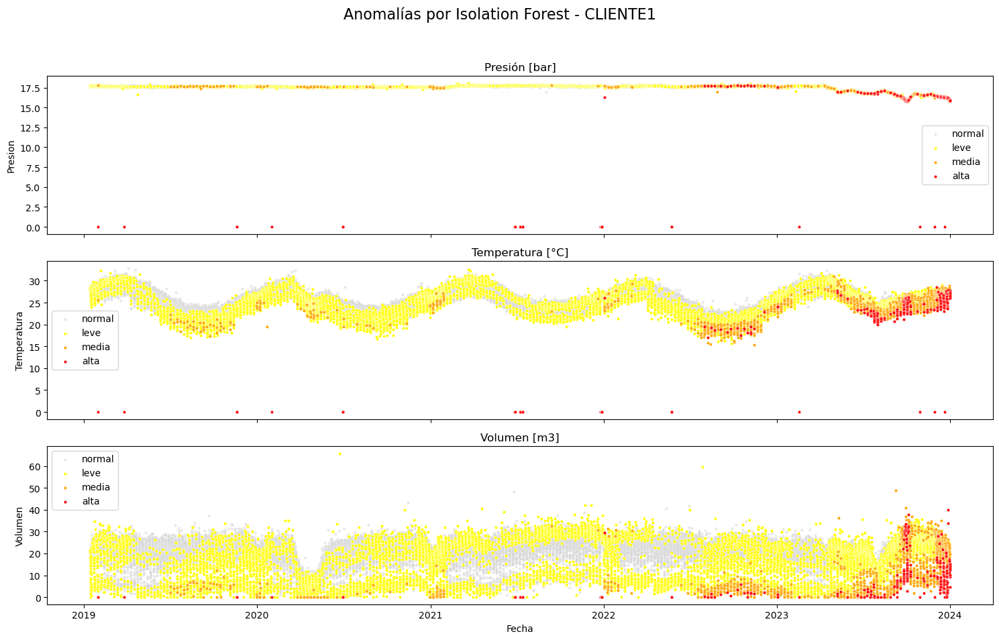

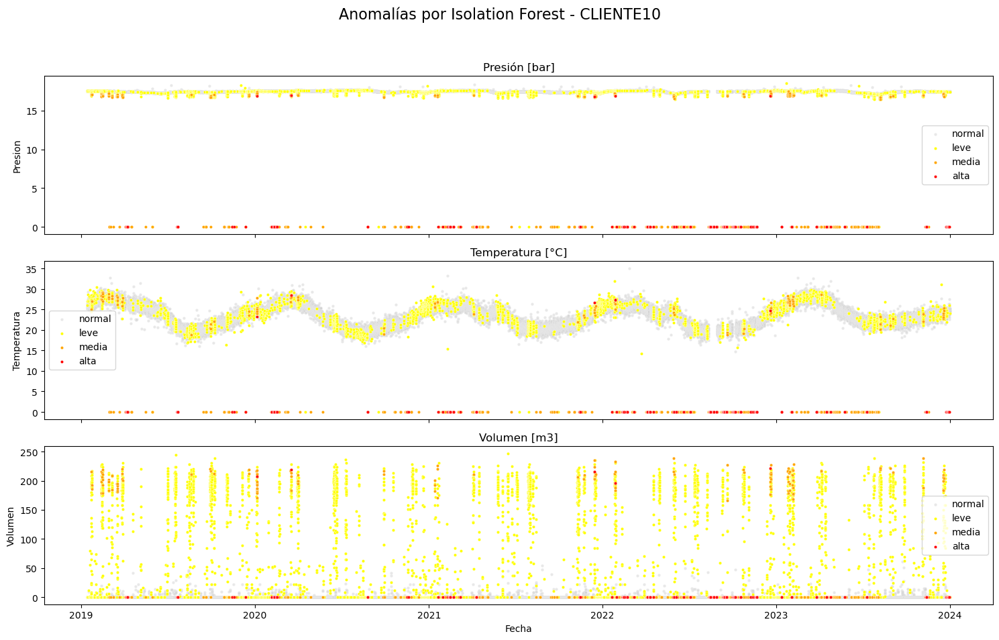

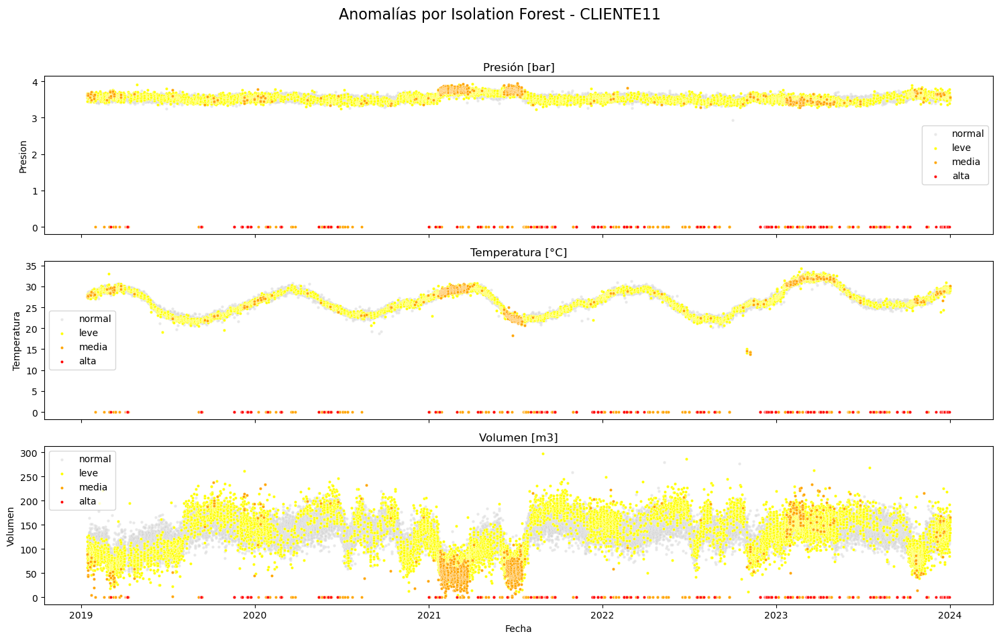

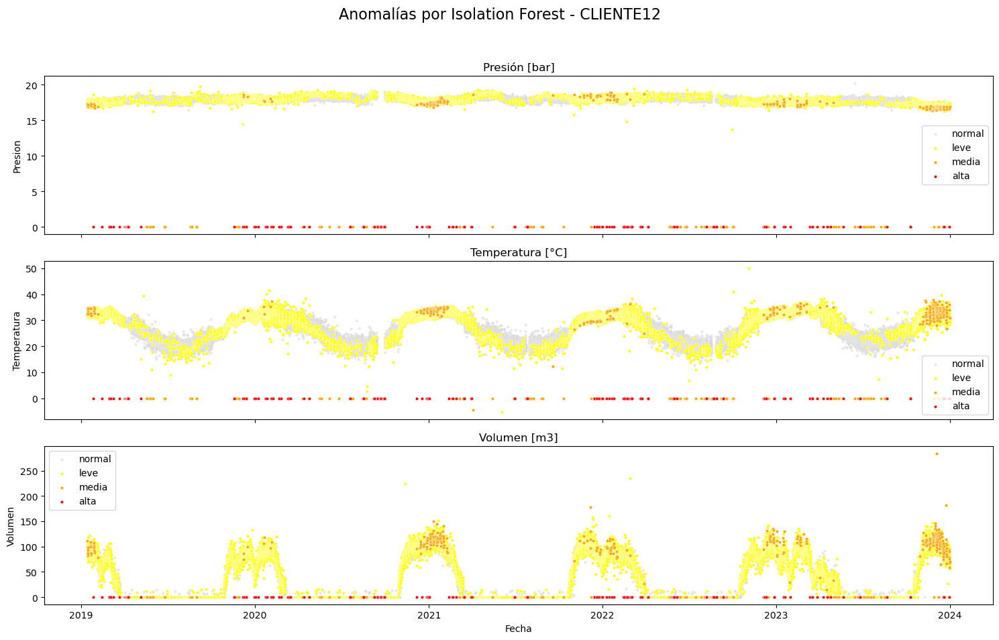

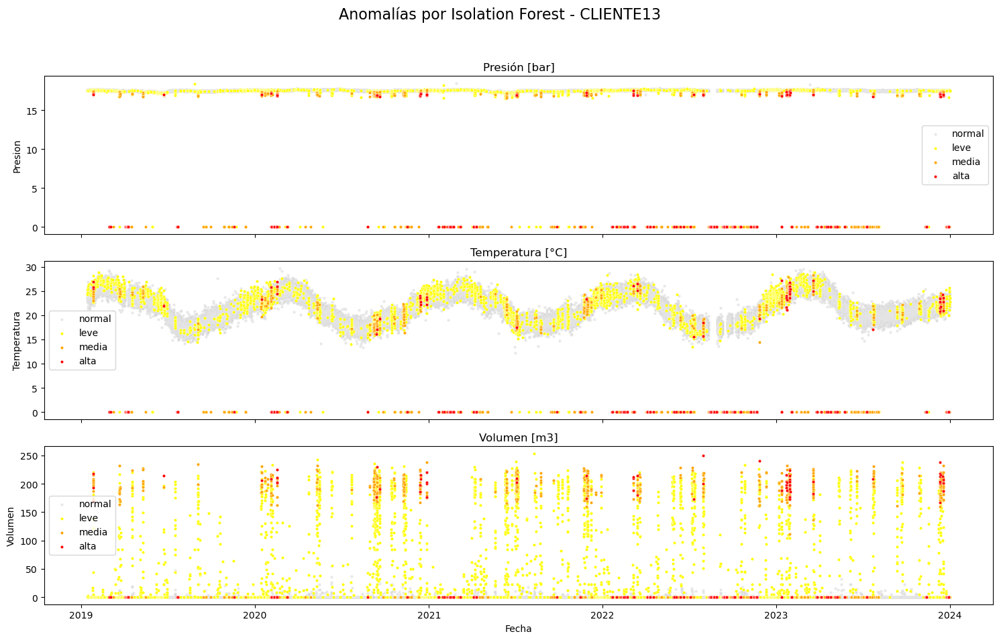

...

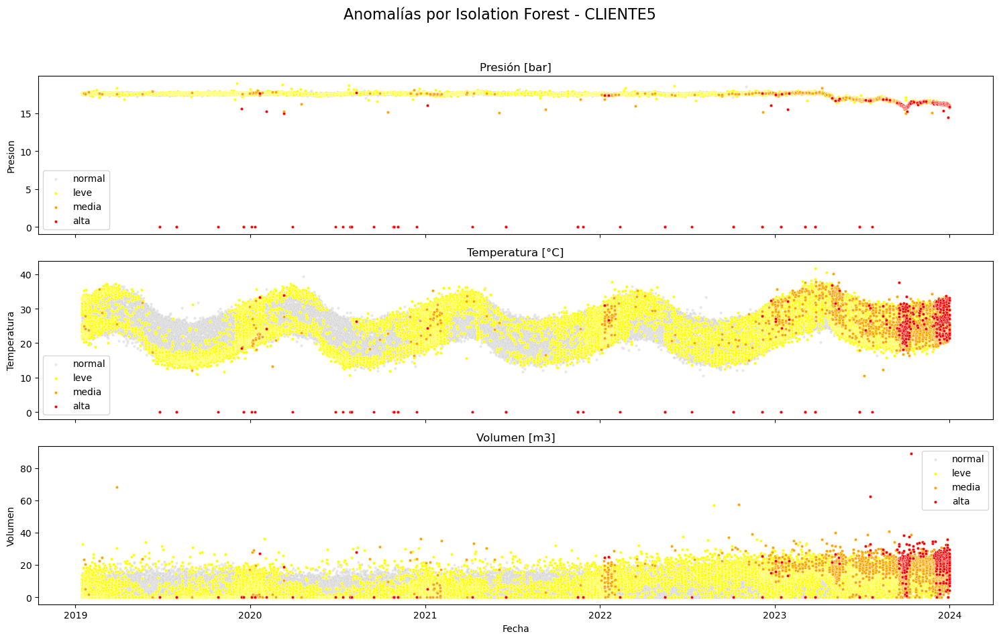

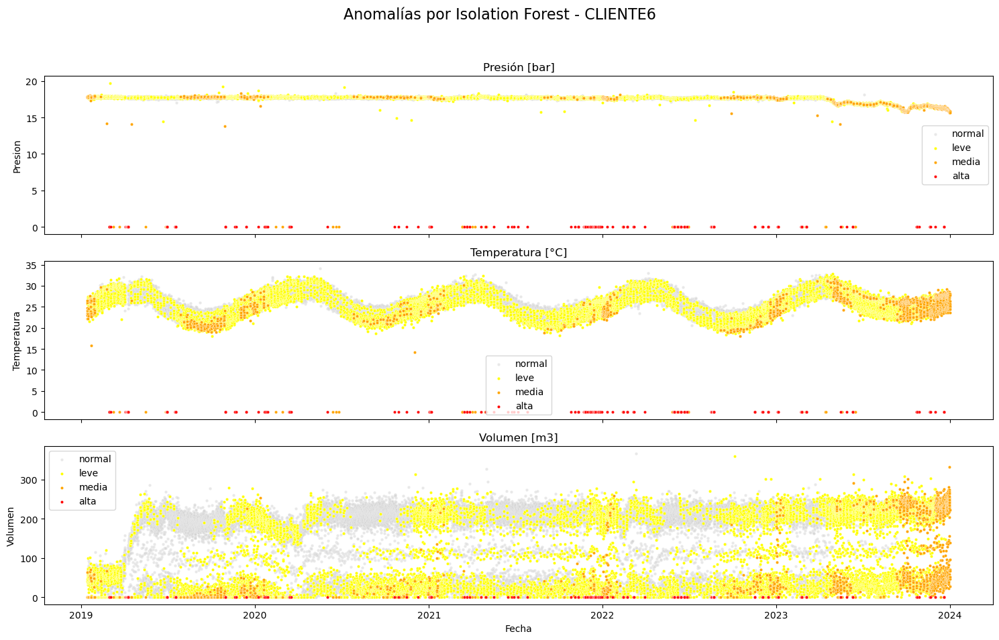

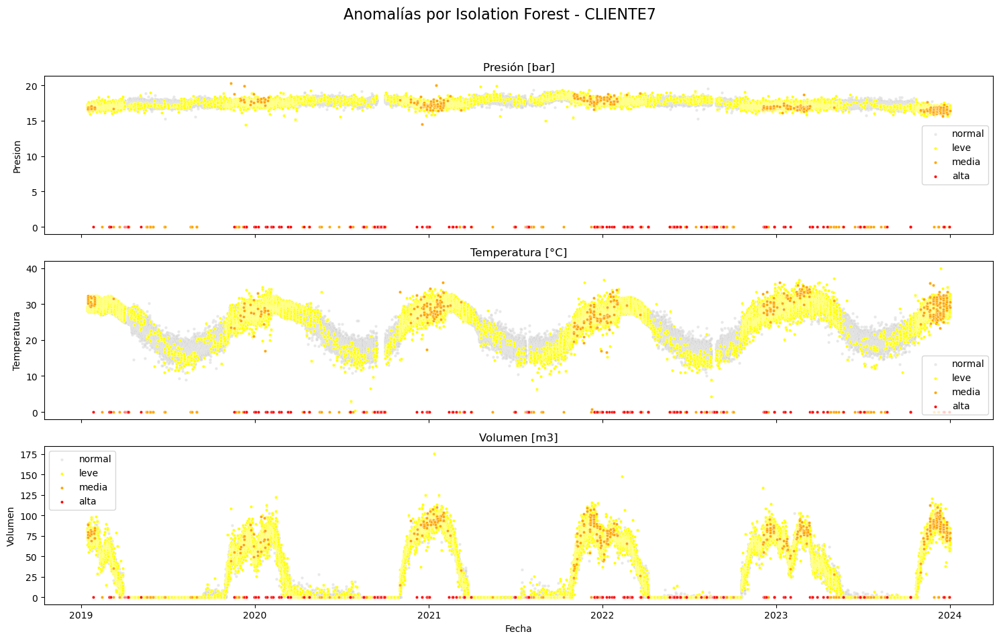

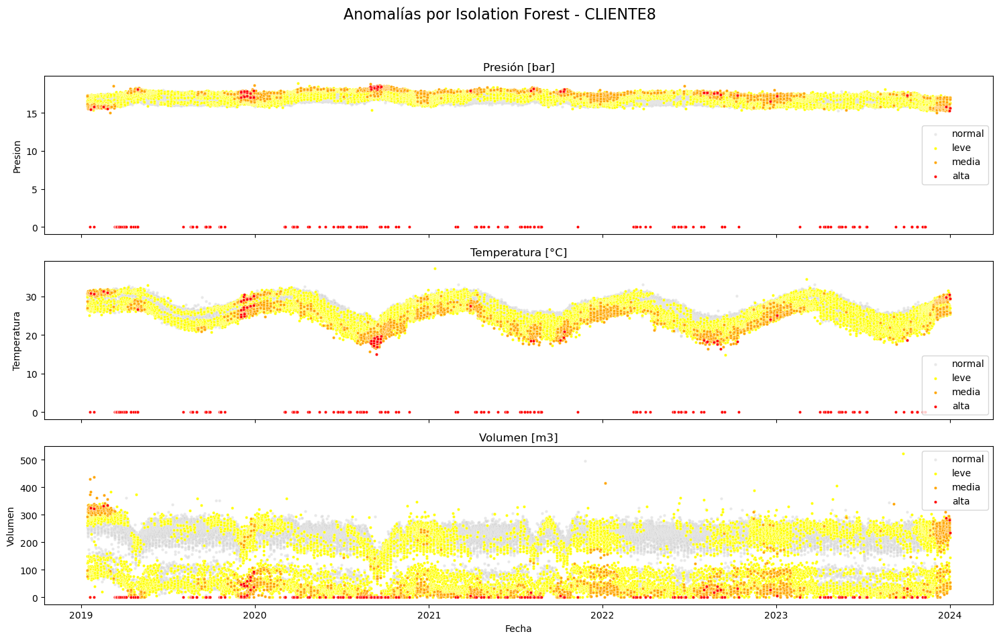

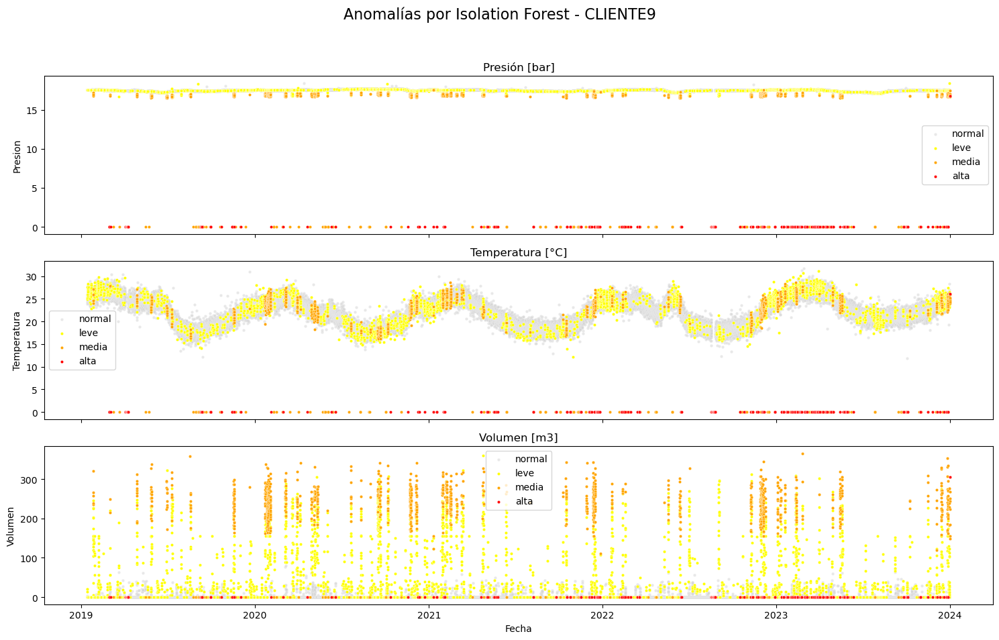

In [30]:
graficar_anomalias_total_clientes(df_iforest_temporal_lags)

## Metricas modelos

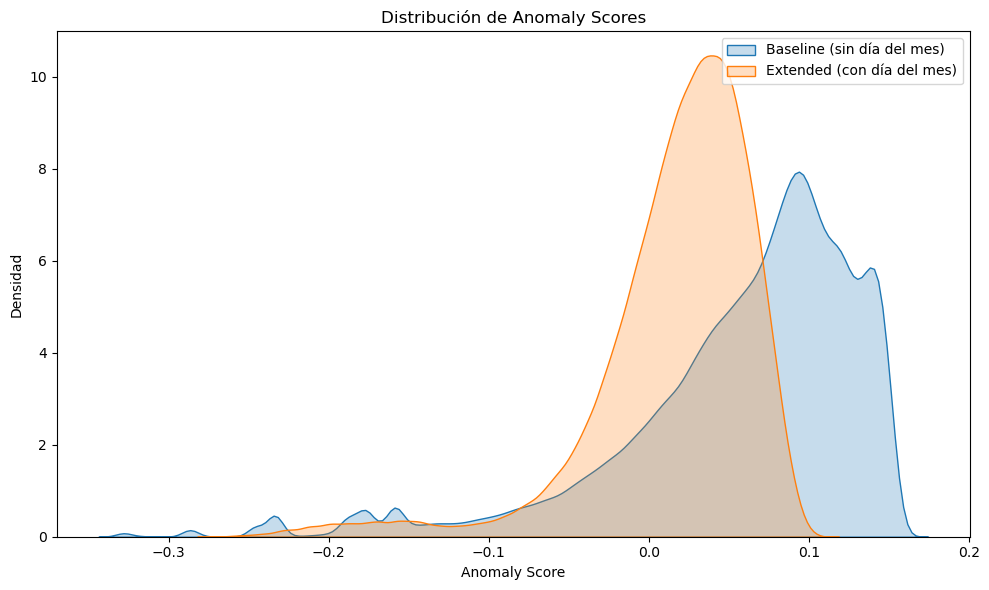

In [31]:
# Convertir y limpiar los scores
baseline_scores = pd.to_numeric(df_iforest['anomaly_score'], errors='coerce').astype(float)
extended_scores = pd.to_numeric(df_iforest_temporal['anomaly_score'], errors='coerce').astype(float)

# Mostrar distribución de scores
plt.figure(figsize=(10, 6))
sns.kdeplot(baseline_scores.dropna(), label='Baseline (sin día del mes)', fill=True)
sns.kdeplot(extended_scores.dropna(), label='Extended (con día del mes)', fill=True)
plt.title("Distribución de Anomaly Scores")
plt.xlabel("Anomaly Score")
plt.ylabel("Densidad")
plt.legend()
plt.tight_layout()
plt.show()

In [32]:
# Step 1: Reset indices to ensure alignment
# df_baseline = df_iforest.reset_index(drop=True)
# df_extended = df_iforest_temporal.reset_index(drop=True)

# Step 2: Create boolean masks
baseline_anomalies = df_iforest['anomaly_label'] == 'anomalía'
extended_anomalies = df_iforest_temporal['anomaly_label'] == 'anomalía'

# Step 3: Create combined classification
conditions = {
    'Both Anomaly': baseline_anomalies & extended_anomalies,
    'Only Baseline': baseline_anomalies & ~extended_anomalies,
    'Only Extended': ~baseline_anomalies & extended_anomalies,
    'Both Normal': ~baseline_anomalies & ~extended_anomalies
}

# Step 4: Count rows that satisfy each condition
overlap_counts = {label: condition.sum() for label, condition in conditions.items()}

# Step 5: Convert to DataFrame
overlap_df = pd.DataFrame(list(overlap_counts.items()), columns=['Tipo de Coincidencia', 'Cantidad'])
overlap_df

,Tipo de Coincidencia,Cantidad
0,Both Anomaly,124410
1,Only Baseline,22676
2,Only Extended,117032
3,Both Normal,606136


In [33]:
import os
PROJECT_DIR = os.path.dirname(os.path.abspath(os.getcwd()))
PROJECT_DIR = os.path.dirname(os.path.abspath(__file__))
print(PROJECT_DIR)

NameError: name '__file__' is not defined